In [1]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


sift = cv2.xfeatures2d.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[1], descs[0])     # between image 0 and image 1
matches2 = bf.match(descs[0], descs[2])     # between image 2 and image 1

[ WARN:0@0.101] global shadow_sift.hpp:13 SIFT_create DEPRECATED: cv.xfeatures2d.SIFT_create() is deprecated due SIFT tranfer to the main repository. https://github.com/opencv/opencv/issues/16736


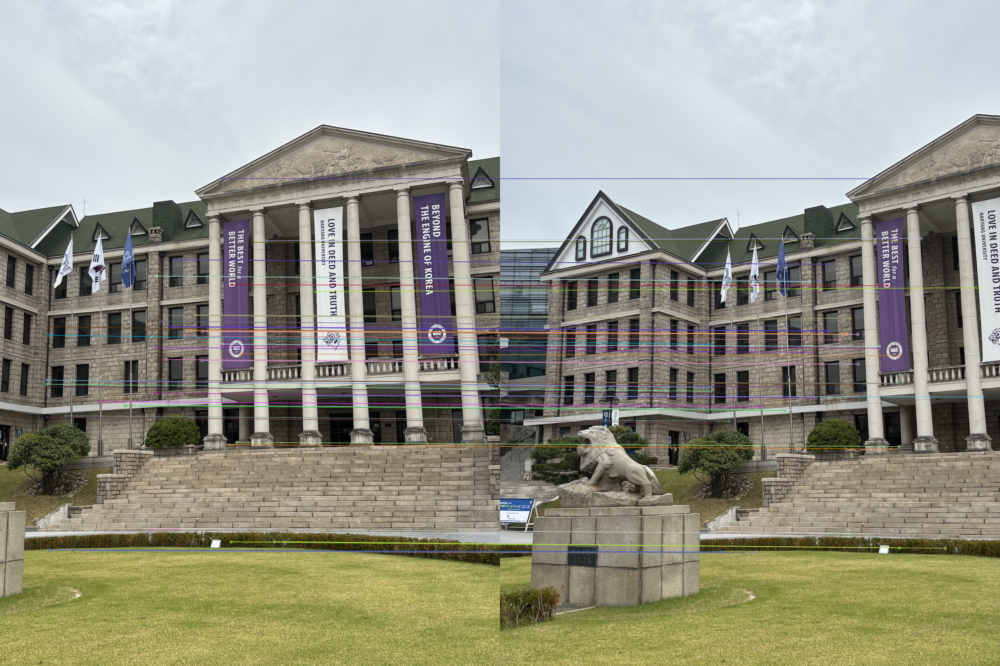

In [2]:

sorted_matches = sorted(matches1, key = lambda x : x.distance)
res = cv2.drawMatches(images[1], kps[1], images[0], kps[0], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

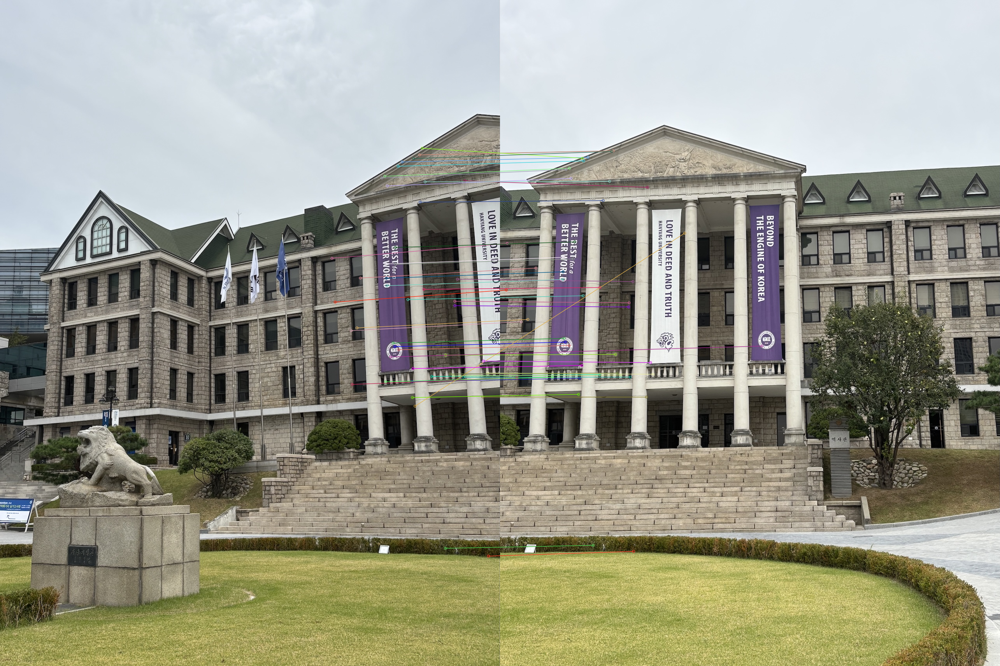

In [3]:
sorted_matches = sorted(matches2, key = lambda x : x.distance)
res = cv2.drawMatches(images[0], kps[0], images[2], kps[2], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

In [46]:
import numpy as np
import cv2

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]


sift = cv2.xfeatures2d.SIFT_create()
kps = []
descs = []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])     # between image 0 and image 1
matches2 = bf.match(descs[2], descs[1])     # between image 2 and image 1

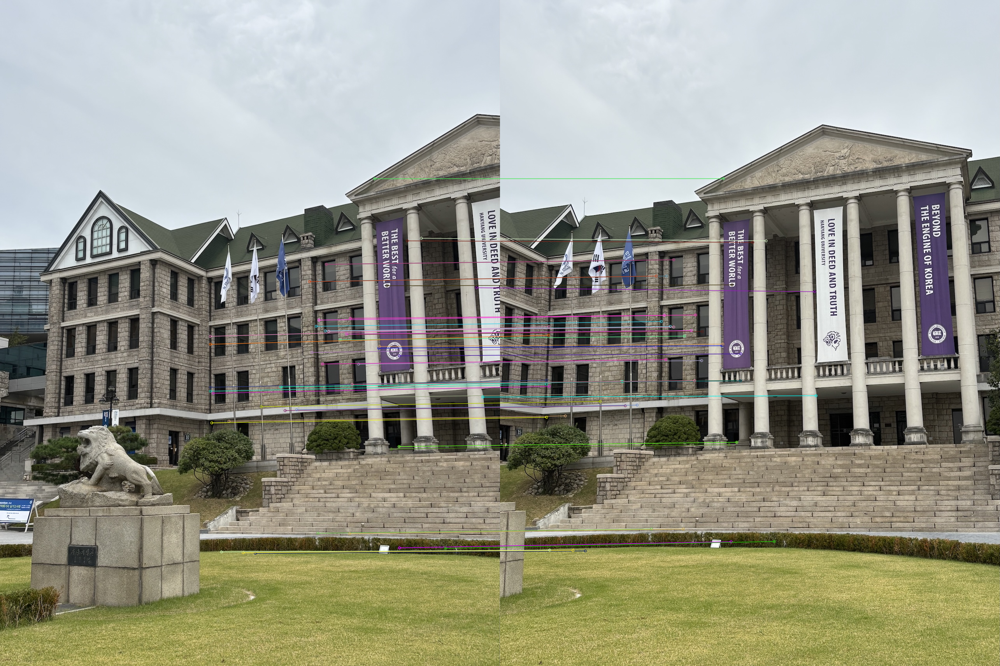

In [47]:
sorted_matches = sorted(matches1, key = lambda x : x.distance)
res = cv2.drawMatches(images[0], kps[0], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))


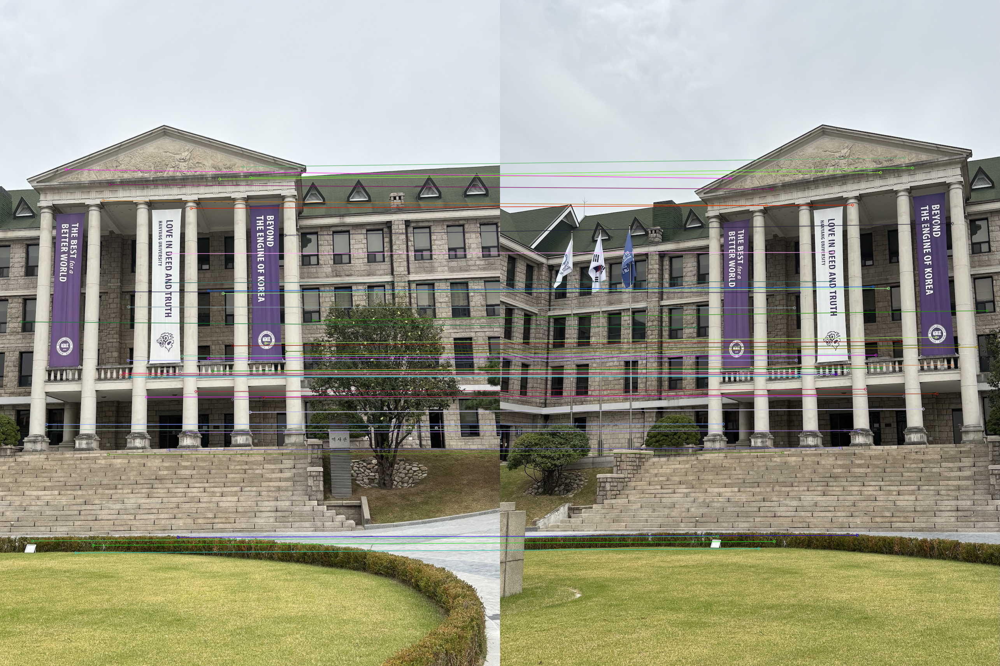

In [48]:
sorted_matches = sorted(matches2, key = lambda x : x.distance)
res = cv2.drawMatches(images[2], kps[2], images[1], kps[1], sorted_matches[:50], None, flags = 2)

from PIL import Image
Image.fromarray(cv2.cvtColor(res, cv2.COLOR_BGR2RGB))

In [49]:
height, width, _ = images[0].shape
result = np.zeros((height, width * 3, 3), dtype = np.uint8)

# Stitch image2 to image1
src = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)

# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 2
after = np.dot(H, before)
after = after / after[2, :]
after = after[:2, :]
after = np.round(after, 0).astype(int)


for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] >= height:
        continue

    if np.sum(pt2 < 0) >= 1:
        continue

    result[pt2[1], width+pt2[0]] = images[2][pt1[1], pt1[0]]


# Stitch image0 to image1
src = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape((-1, 1, 2))
dst = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape((-1, 1, 2))
H, status = cv2.findHomography(src, dst, cv2.RANSAC, 5.0)


# Prepare pixel coordinates in image1
before = []
for x in range(images[1].shape[1]):
    for y in range(images[1].shape[0]):
        point = [x, y, 1]
        before.append(point)
before = np.array(before).transpose()

# [TODO] Calculate coordinates for each pixel in image1 to image 0
after = np.dot(H, before)
after = after / after[2, :]
after = after[:2, :]
after = after.astype(int)
after[0] += width

for pt1, pt2 in zip(before[:2, :].transpose(), after.transpose()):
    if pt2[1] < 0 or pt2[1] >= height:
        continue

    if any(pt2 < 0):
        continue

    result[pt2[1], pt2[0]] = images[0][pt1[1], pt1[0]]
result[0:height, width:width*2] = images[1]

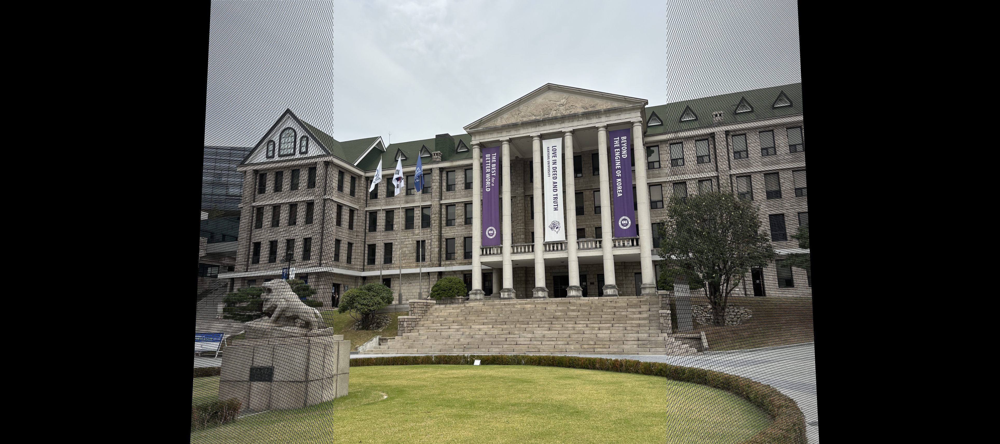

In [50]:
from PIL import Image
Image.fromarray(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))

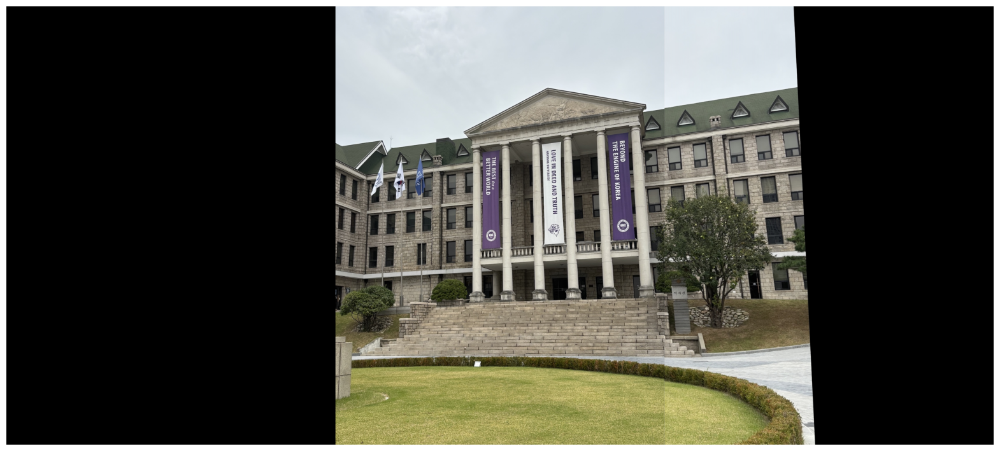

In [51]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

images = [cv2.imread('data/hyu_{}.jpeg'.format(i)) for i in range(3)]
grays = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]

sift = cv2.SIFT_create()
kps, descs = [], []
for gray in grays:
    kp, desc = sift.detectAndCompute(gray, None)
    kps.append(kp)
    descs.append(desc)

bf = cv2.BFMatcher()
matches1 = bf.match(descs[0], descs[1])  # 이미지 0과 1 매칭
matches2 = bf.match(descs[2], descs[1])  # 이미지 2와 1 매칭

# 호모그래피 계산
src0 = np.float32([kps[0][m.queryIdx].pt for m in matches1]).reshape(-1, 1, 2)
dst0 = np.float32([kps[1][m.trainIdx].pt for m in matches1]).reshape(-1, 1, 2)
H0, _ = cv2.findHomography(src0, dst0, cv2.RANSAC, 5.0)

src2 = np.float32([kps[2][m.queryIdx].pt for m in matches2]).reshape(-1, 1, 2)
dst2 = np.float32([kps[1][m.trainIdx].pt for m in matches2]).reshape(-1, 1, 2)
H2, _ = cv2.findHomography(src2, dst2, cv2.RANSAC, 5.0)

# 캔버스 크기
height, width, _ = images[1].shape
canvas_width = width * 3
result = np.zeros((height, canvas_width, 3), dtype=np.uint8)

# 이미지 0 맞추기
H0_adjusted = np.array([[1, 0, -width], [0, 1, 0], [0, 0, 1]]) @ H0
warped_img0 = cv2.warpPerspective(images[0], H0_adjusted, (canvas_width, height))
result[:, :width] = warped_img0[:, :width]

# 이미지 1 중앙
result[:, width:width*2] = images[1]

# 이미지 2 오맞추기
H2_adjusted = np.array([[1, 0, width], [0, 1, 0], [0, 0, 1]]) @ H2
warped_img2 = cv2.warpPerspective(images[2], H2_adjusted, (canvas_width, height))
result[:, width*2:] = warped_img2[:, width*2:]

# 블렌딩
def blend_images(img1, img2, mask):
    mask = np.dstack([mask] * 3) 
    blurred_mask = cv2.GaussianBlur(mask, (21, 21), 0)
    return (img1 * (1 - blurred_mask) + img2 * blurred_mask).astype(np.uint8)

# 왼쪽 경계 블렌딩
mask_left = np.zeros((height, width), dtype=np.float32)
mask_left[:, :] = np.linspace(1, 0, width)
result[:, :width] = blend_images(result[:, :width], warped_img0[:, :width], mask_left)

# 오른쪽 경계 블렌딩
mask_right = np.zeros((height, width), dtype=np.float32)
mask_right[:, :] = np.linspace(0, 1, width)
result[:, width*2:] = blend_images(result[:, width*2:], warped_img2[:, width*2:], mask_right)

#시각화
plt.figure(figsize=(20, 10))
plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()
